In [100]:
import seaborn as sns
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
import sklearn

# data = pd.read_csv('dataset.csv')[:135] # to get Conv layer 3 data only
data = pd.read_csv('dataset.csv') # to get Conv layer 3 and Conv layer 20 data

# Extracting Attributes / Features
X=data.drop(['time','type'],axis=1)

# Extracting Target / Class Labels
# y=data['time']/1000
y=data['type']
columns = ['warp_execution_efficiency', 'gld_efficiency', 'gst_efficiency','stall_inst_fetch','stall_exec_dependency','stall_memory_dependency','stall_sync','stall_pipe_busy','shared_efficiency','achieved_occupancy','l2_utilization','shared_utilization','ldst_fu_utilization','cf_fu_utilization','special_fu_utilization','tex_fu_utilization','single_precision_fu_utilization','double_precision_fu_utilization','dram_utilization']
y[y=='trt'] = 0
y[y=='cublas'] = 1
y[y=='cudnn'] = 2
y = y.astype('int')
data

/var/folders/mc/zcjlsdvn5017_9l5yqktyr0r0000gn/T/ipykernel_2674/3272111151.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y[y=='trt'] = 0
/var/folders/mc/zcjlsdvn5017_9l5yqktyr0r0000gn/T/ipykernel_2674/3272111151.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y[y=='cublas'] = 1
/var/folders/mc/zcjlsdvn5017_9l5yqktyr0r0000gn/T/ipykernel_2674/3272111151.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y[y=='cudnn'] = 2


,type,warp_execution_efficiency,gld_efficiency,gst_efficiency,stall_inst_fetch,stall_exec_dependency,stall_memory_dependency,stall_sync,stall_pipe_busy,shared_efficiency,...,l2_utilization,shared_utilization,ldst_fu_utilization,cf_fu_utilization,special_fu_utilization,tex_fu_utilization,single_precision_fu_utilization,double_precision_fu_utilization,dram_utilization,time
0,0,1.0,0.59,0.57,0.08,0.22,0.15,0.18,0.03,0.71,...,0.20,0.60,0.20,0.1,0.10,0.20,0.80,0.0,0.40,260.49
1,1,1.0,0.94,1.00,0.06,0.11,0.49,0.09,0.02,0.42,...,0.29,0.30,0.16,0.1,0.12,0.18,0.73,0.0,0.62,982.62
2,2,1.0,0.82,0.75,0.09,0.30,0.11,0.13,0.03,0.62,...,0.20,0.62,0.26,0.1,0.16,0.22,0.77,0.0,0.48,360.58
3,0,1.0,0.59,0.57,0.08,0.22,0.15,0.18,0.03,0.71,...,0.20,0.60,0.20,0.1,0.10,0.20,0.80,0.0,0.40,260.75
4,1,1.0,0.94,1.00,0.07,0.11,0.50,0.09,0.02,0.42,...,0.29,0.30,0.16,0.1,0.12,0.18,0.70,0.0,0.65,982.63
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
256,1,1.0,0.92,0.88,0.05,0.08,0.20,0.13,0.05,0.37,...,0.13,0.41,0.18,0.1,0.02,0.22,0.86,0.0,0.47,798.50
257,2,1.0,0.84,0.74,0.04,0.26,0.16,0.20,0.01,0.77,...,0.20,0.58,0.26,0.1,0.09,0.20,0.75,0.0,0.73,643.51
258,0,1.0,0.54,1.00,0.04,0.12,0.29,0.22,0.01,0.68,...,0.20,0.60,0.20,0.1,0.10,0.20,0.80,0.0,0.80,355.40
259,1,1.0,0.92,0.88,0.04,0.08,0.22,0.12,0.04,0.37,...,0.13,0.41,0.18,0.1,0.02,0.22,0.86,0.0,0.45,799.10


In [101]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25, random_state=11, shuffle=True)

MAE:  1.4628821030355003e-15


TypeError: set_ticks() got an unexpected keyword argument 'labels'

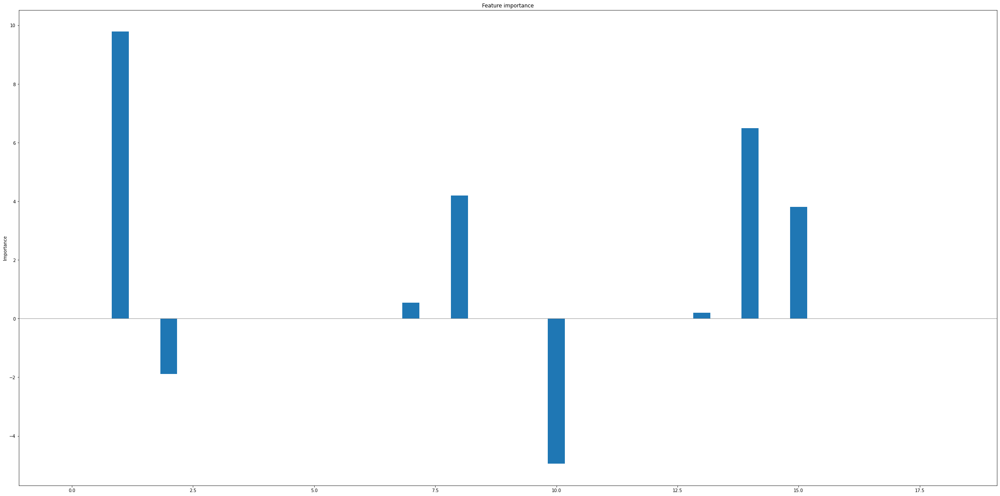

In [92]:
# linear regression feature importance
from sklearn.datasets import make_regression
from sklearn.linear_model import LinearRegression

# define the model
model = LinearRegression()
# fit the model
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('MAE: ',mean_absolute_error(y_pred, y_test))
# get importance
importance = model.coef_
# # summarize feature importance
# for i,v in enumerate(importance):
# 	print('Feature: '+columns[i]+', Score: %.5f' % (v))
# # plot feature importance
# plt.bar([x for x in range(len(importance))], importance)
# plt.show()

# from matplotlib.pyplot import figure

# figure(figsize=(20, 6), dpi=80)
plt.rcParams["figure.figsize"] = (40,20)

N = len(importance)
ind = np.arange(N)    # the x locations for the groups
width = 0.35       # the width of the bars: can also be len(x) sequence
fig, ax = plt.subplots()

p1 = ax.bar(ind, importance, width, label='Importance')
# p2 = ax.bar(ind, womenMeans, width,
#             bottom=menMeans, yerr=womenStd, label='Women')

ax.axhline(0, color='grey', linewidth=0.8)
ax.set_ylabel('Importance')
ax.set_title('Feature importance')
ax.set_xticks(ind, labels=columns)
ax.legend()

# Label with label_type 'center' instead of the default 'edge'
ax.bar_label(p1, label_type='edge')
# ax.bar_label(p2, label_type='center')
# ax.bar_label(p2)

plt.show()

MAE:  0.0027694597926817325
Feature: warp_execution_efficiency, Score: 0.00000
Feature: gld_efficiency, Score: 0.04009
Feature: gst_efficiency, Score: 0.05003
Feature: stall_inst_fetch, Score: 0.00001
Feature: stall_exec_dependency, Score: 0.10951
Feature: stall_memory_dependency, Score: 0.06280
Feature: stall_sync, Score: 0.06046
Feature: stall_pipe_busy, Score: 0.06907
Feature: shared_efficiency, Score: 0.09050
Feature: achieved_occupancy, Score: 0.08951
Feature: l2_utilization, Score: 0.05921
Feature: shared_utilization, Score: 0.12840
Feature: ldst_fu_utilization, Score: 0.06996
Feature: cf_fu_utilization, Score: 0.00000
Feature: special_fu_utilization, Score: 0.00085
Feature: tex_fu_utilization, Score: 0.05988
Feature: single_precision_fu_utilization, Score: 0.06014
Feature: double_precision_fu_utilization, Score: 0.00000
Feature: dram_utilization, Score: 0.04959


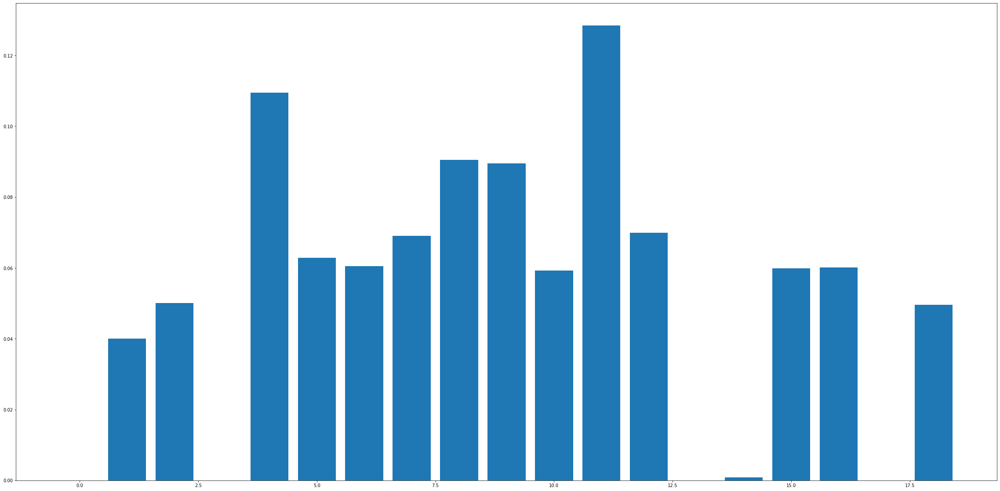

In [16]:
# random forest for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.ensemble import RandomForestRegressor

# define the model
model = RandomForestRegressor()
# fit the model
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('MAE: ',mean_absolute_error(y_pred, y_test))# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
	print('Feature: '+columns[i]+', Score: %.5f' % (v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

MAE:  0.08975902451463824
Feature: warp_execution_efficiency, Score: 0.00000
Feature: gld_efficiency, Score: 0.00507
Feature: gst_efficiency, Score: 0.01520
Feature: stall_inst_fetch, Score: 0.00003
Feature: stall_exec_dependency, Score: 0.00276
Feature: stall_memory_dependency, Score: 0.02091
Feature: stall_sync, Score: 0.00032
Feature: stall_pipe_busy, Score: 0.00001
Feature: shared_efficiency, Score: 0.00664
Feature: achieved_occupancy, Score: 0.00038
Feature: l2_utilization, Score: 0.00076
Feature: shared_utilization, Score: 0.00722
Feature: ldst_fu_utilization, Score: 0.00047
Feature: cf_fu_utilization, Score: 0.00000
Feature: special_fu_utilization, Score: 0.00001
Feature: tex_fu_utilization, Score: 0.00009
Feature: single_precision_fu_utilization, Score: 0.00018
Feature: double_precision_fu_utilization, Score: 0.00000
Feature: dram_utilization, Score: 0.00251


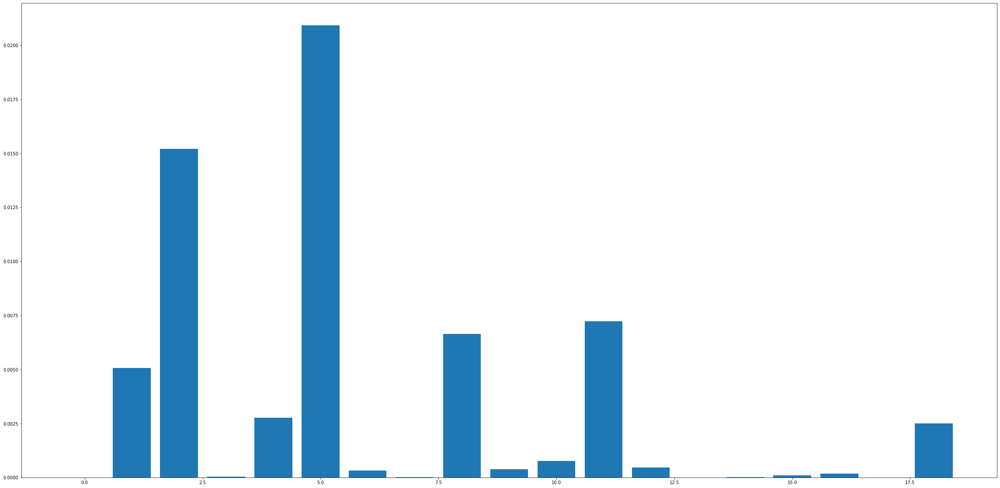

In [17]:
# permutation feature importance with knn for regression
from sklearn.datasets import make_regression
from sklearn.svm import SVR
from sklearn.inspection import permutation_importance
from matplotlib import pyplot
# define the model
model = SVR()
# fit the model
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('MAE: ',mean_absolute_error(y_pred, y_test))
# perform permutation importance
results = permutation_importance(model, X, y, scoring='neg_mean_squared_error')
# get importance
importance = results.importances_mean
# summarize feature importance
for i,v in enumerate(importance):
	print('Feature: '+columns[i]+', Score: %.5f' % (v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

MAE:  0.020469747050586656
Feature: warp_execution_efficiency, Score: 0.00000
Feature: gld_efficiency, Score: 0.00105
Feature: gst_efficiency, Score: 0.01157
Feature: stall_inst_fetch, Score: -0.00000
Feature: stall_exec_dependency, Score: 0.00123
Feature: stall_memory_dependency, Score: 0.01501
Feature: stall_sync, Score: 0.00049
Feature: stall_pipe_busy, Score: 0.00003
Feature: shared_efficiency, Score: 0.00542
Feature: achieved_occupancy, Score: -0.00000
Feature: l2_utilization, Score: 0.00003
Feature: shared_utilization, Score: 0.00998
Feature: ldst_fu_utilization, Score: -0.00004
Feature: cf_fu_utilization, Score: 0.00000
Feature: special_fu_utilization, Score: -0.00001
Feature: tex_fu_utilization, Score: 0.00006
Feature: single_precision_fu_utilization, Score: 0.00004
Feature: double_precision_fu_utilization, Score: 0.00000
Feature: dram_utilization, Score: 0.00020


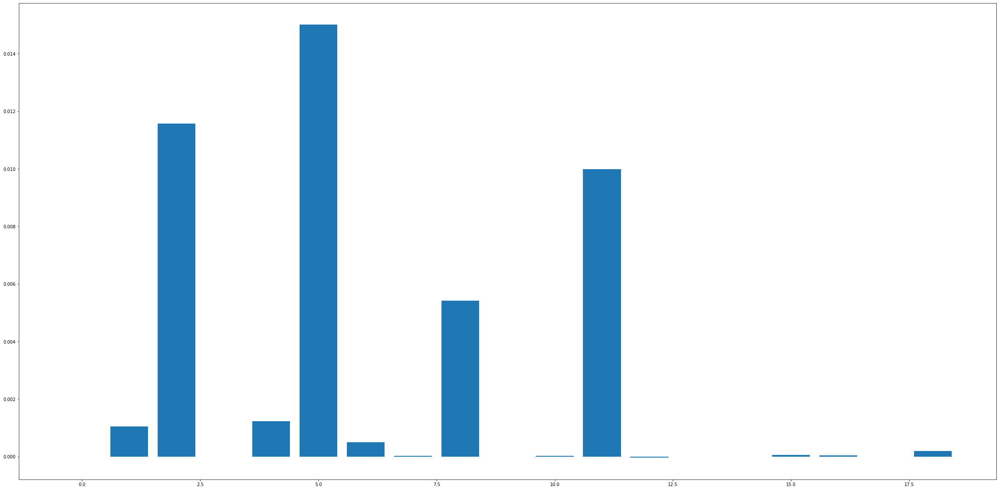

In [18]:

# permutation feature importance with knn for regression
from sklearn.datasets import make_regression
from sklearn.neural_network import MLPRegressor
from sklearn.inspection import permutation_importance
from matplotlib import pyplot
# define the model
model = MLPRegressor()
# fit the model
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('MAE: ',mean_absolute_error(y_pred, y_test))

# perform permutation importance
results = permutation_importance(model, X, y, scoring='neg_mean_squared_error')
# get importance
importance = results.importances_mean
# summarize feature importance
for i,v in enumerate(importance):
	print('Feature: '+columns[i]+', Score: %.5f' % (v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

In [58]:
import requests


url_linreg = 'https://raw.githubusercontent.com/ankonzoid/LearningX/master/advanced_ML/model_tree/models/linear_regr.py'
url_logreg = 'https://raw.githubusercontent.com/ankonzoid/LearningX/master/advanced_ML/model_tree/models/logistic_regr.py'
url_modeltree='https://raw.githubusercontent.com/ankonzoid/LearningX/master/advanced_ML/model_tree/src/ModelTree.py'

r = requests.get(url_linreg, allow_redirects=True)
with open('linear_regr.py', 'wb') as file:
  file.write(r.content)

r = requests.get(url_logreg, allow_redirects=True)
with open('logistic_regr.py', 'wb') as file:
  file.write(r.content)

r = requests.get(url_modeltree, allow_redirects=True)
with open('ModelTree.py', 'wb') as file:
  file.write(r.content)


# from google.colab import files
# uploaded = files.upload()

In [66]:
from ModelTree import ModelTree
from linear_regr import linear_regr
from logistic_regr import logistic_regr
model = linear_regr()
# model = logistic_regr()
model = ModelTree(model, max_depth=10, min_samples_leaf=20,search_type="greedy", n_search_grid=100)

model.fit(np.array(X_train), np.array(y_train))
y_pred = model.predict(np.array(X_test))
print('MAE: ',mean_absolute_error(y_pred, np.array(y_test)))
print(y_pred,np.array(y_test))
model.export_graphviz('lmt',columns,export_png=True)

MAE:  0.0026775883745007757
[0.26414295 0.26599815 0.3540802  0.26421226 0.26421226 0.26421226
 0.26599815 0.26421226 0.98418784 0.26421226 0.35368347 0.98222232
 0.36018372 0.26421226 0.98418784 0.35816555 0.98242188 0.98321533
 0.98577762 0.9831543  0.26421226 0.98259783 0.26421226 0.26599815
 0.26599815 0.98418784 0.35368347 0.3545711  0.35824377 0.35951233
 0.97946084 0.35392367 0.98552489 0.26421226] [0.26647 0.26785 0.35485 0.26522 0.26159 0.26735 0.26133 0.26099 0.98233
 0.26049 0.35463 0.97993 0.36058 0.26204 0.98185 0.36145 0.97949 0.98252
 0.98073 0.98413 0.25953 0.98351 0.26785 0.26288 0.25973 0.98229 0.35985
 0.35223 0.36237 0.35767 0.9832  0.35422 0.98671 0.26877]
Saving model tree diagram to 'lmt.png'...


In [10]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import RidgeClassifier
from sklearn.multiclass import OneVsRestClassifier
from lineartree import LinearTreeRegressor, LinearForestClassifier
from sklearn.datasets import make_regression


model = LinearTreeRegressor(base_estimator=LinearRegression(), criterion='mae')

# model = LinearForestClassifier(base_estimator=OneVsRestClassifier(LinearRegression())) #binary class only

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('MAE: ',mean_absolute_error(y_pred, y_test))
model.plot_model(columns)

ModuleNotFoundError: No module named 'lineartree'

In [27]:
from sklearn.linear_model import RidgeClassifier
from sklearn.multiclass import OneVsRestClassifier
from lineartree import LinearTreeRegressor, LinearForestClassifier, LinearBoostClassifier

model = LinearBoostClassifier(base_estimator=RidgeClassifier())
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('MAE: ',mean_absolute_error(y_pred, y_test))
# model.plot_model(columns)

MAE:  0.0


In [41]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.1, random_state=10, shuffle=True)

Accuracy:  1.0


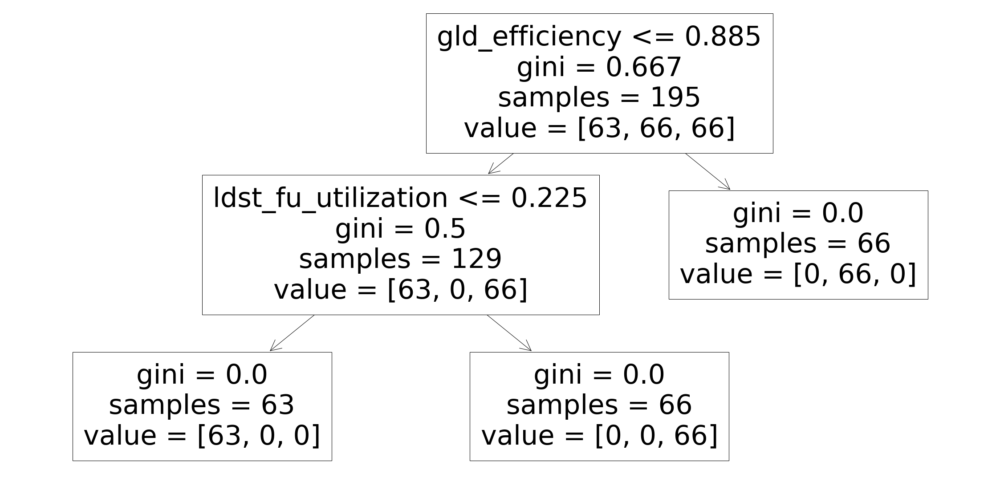

In [112]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.metrics import accuracy_score
model = DecisionTreeClassifier(criterion='gini',splitter='best',max_depth=2,min_samples_split=2, min_samples_leaf=2)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('Accuracy: ',accuracy_score(y_pred, y_test))
tree.plot_tree(model, feature_names=columns)
plt.show()

In [113]:
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
from sklearn.metrics import accuracy_score
model = RandomForestClassifier(n_estimators=100,criterion='entropy',max_depth=2,min_samples_split=2, min_samples_leaf=2)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print('Accuracy: ',accuracy_score(y_pred, y_test))

Accuracy:  1.0


100


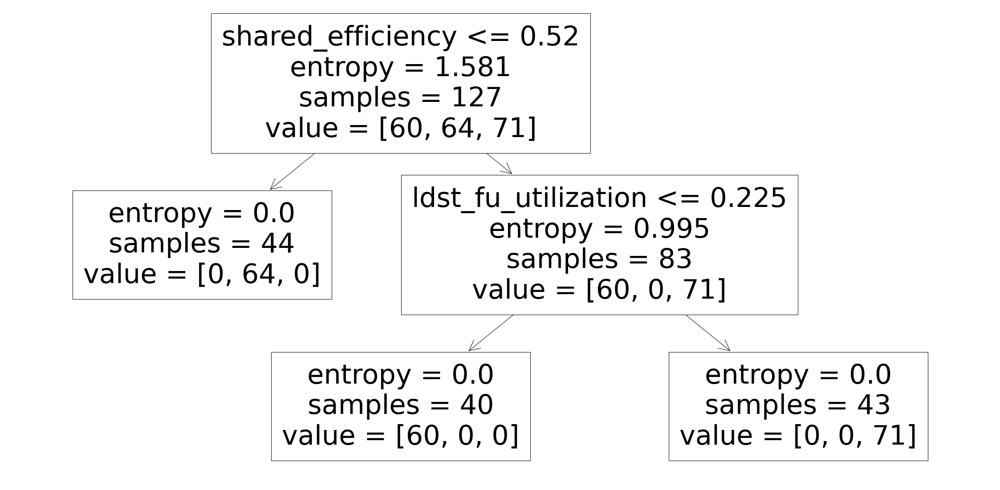

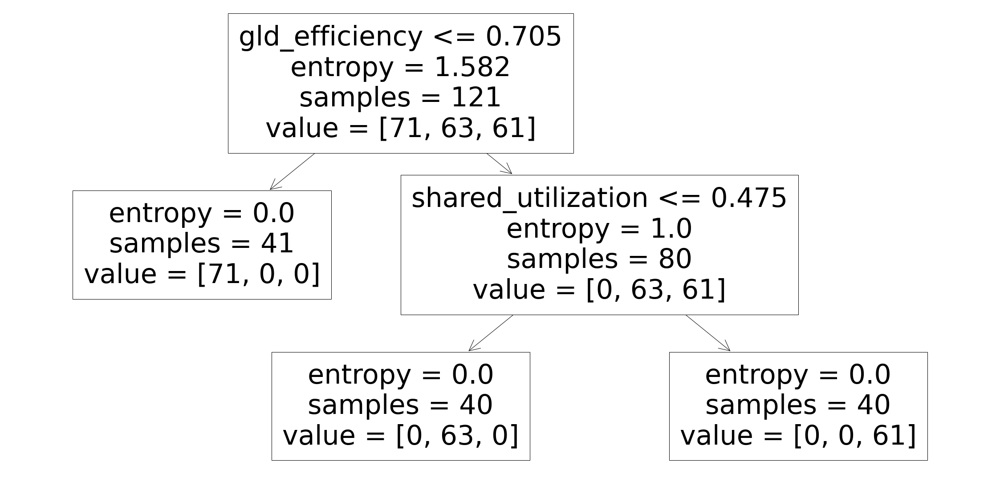

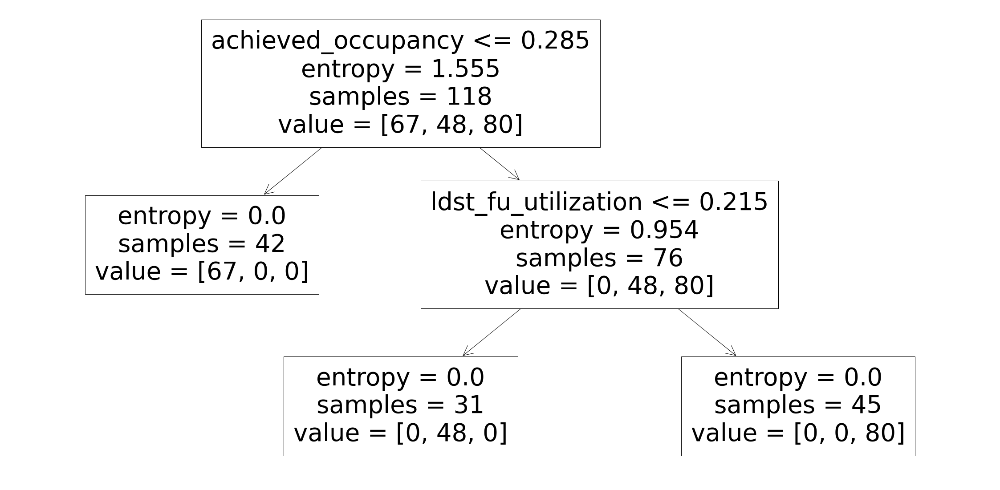

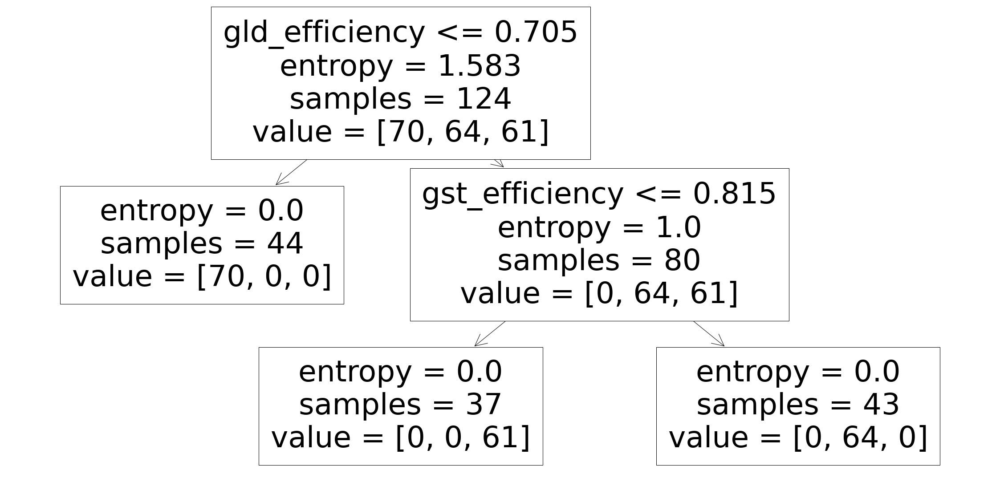

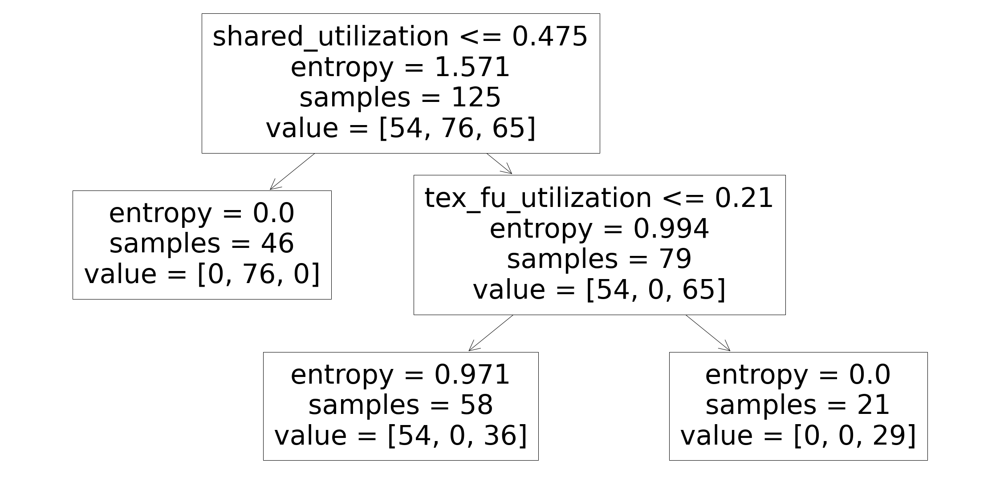

...

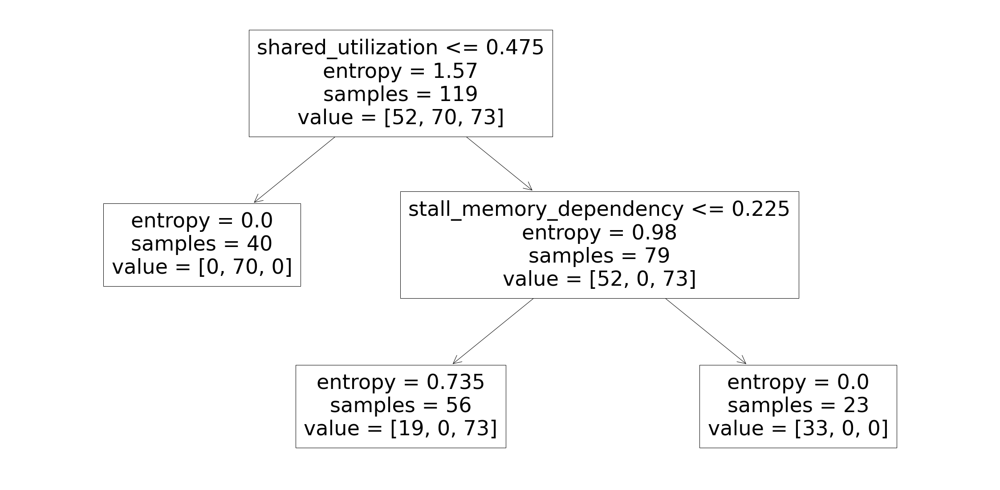

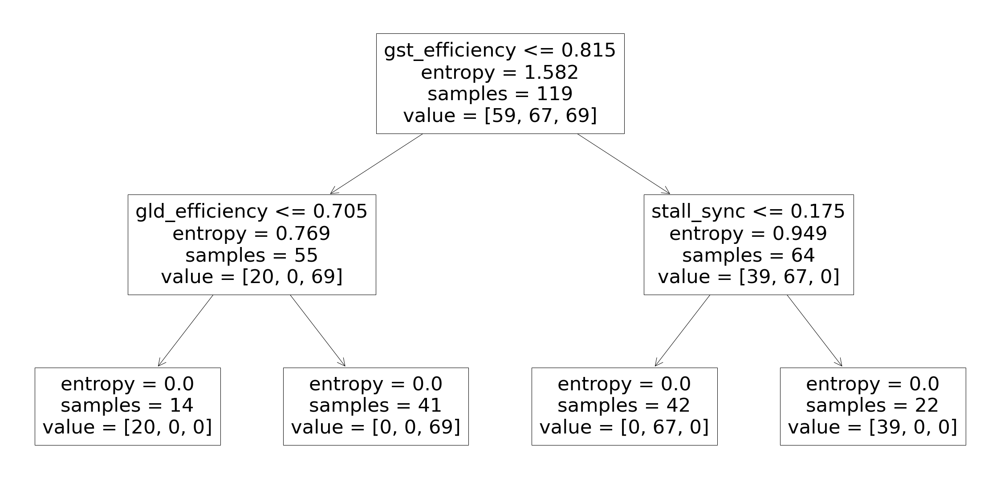

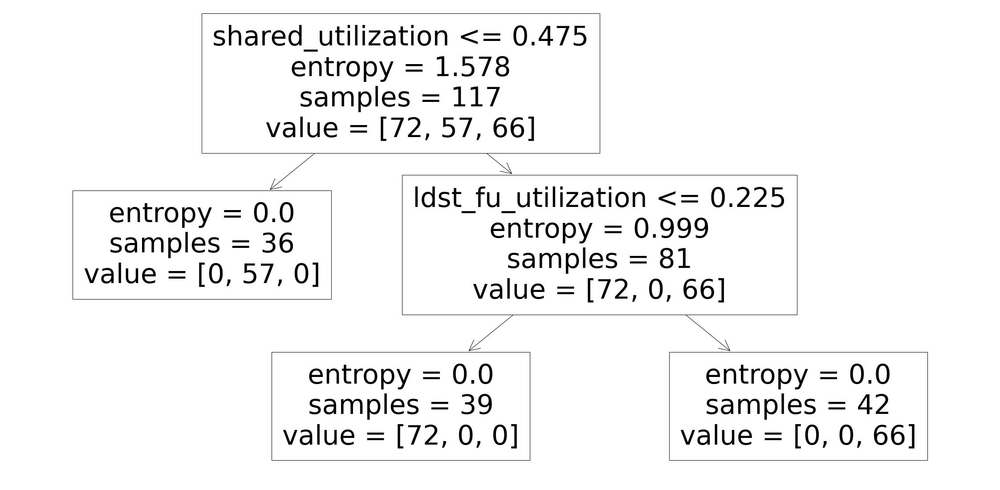

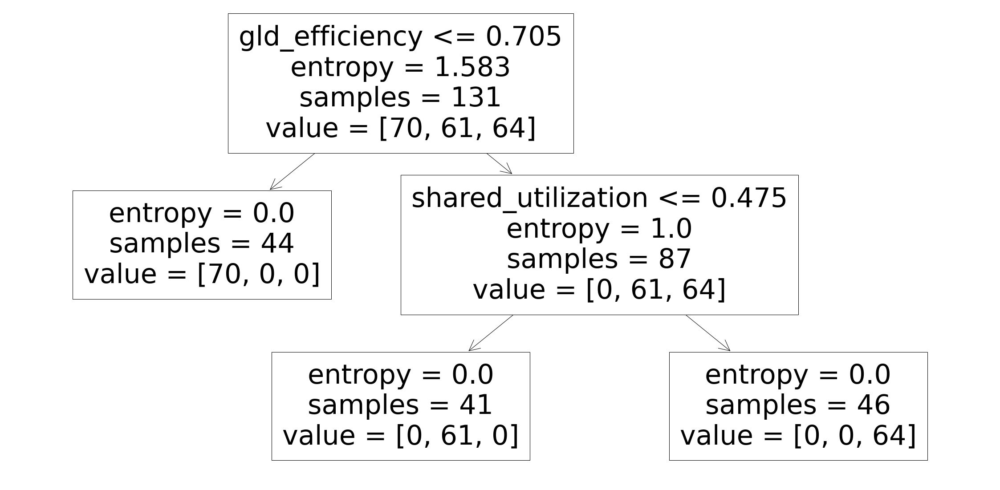

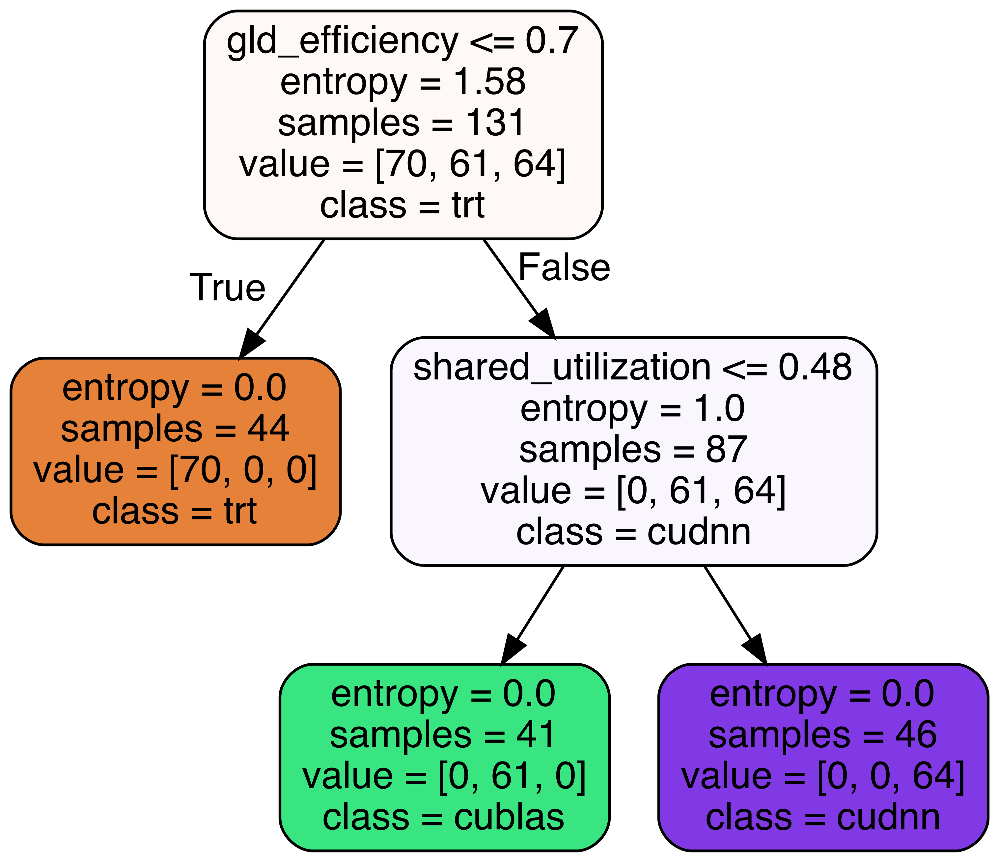

In [114]:
from sklearn.tree import export_graphviz
# Export as dot file
print(len(model.estimators_))
for i in range(len(model.estimators_)):
    estimator = model.estimators_[i]
    desc = tree.plot_tree(estimator, feature_names=columns)
    plt.show()
    desc
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = columns,
                class_names = ['trt','cublas','cudnn'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

In [110]:
from sklearn.tree import export_text

res = []

for i in range(len(model.estimators_)):
    estimator = model.estimators_[i]
    tree = export_text(estimator, feature_names=columns)
    lines = tree.split('\n')
    d1 = ''.join(lines[0].split()[-3])
    if 'class' in lines[1]:
        c1 = int(float(lines[1].split()[-1]))
        d2 = ''.join(lines[3].split()[-3])
        c2 = int(float(lines[4].split()[-1]))
        c3 = int(float(lines[6].split()[-1]))
    else:
        d2 = ''.join(lines[1].split()[-3])
        c2 = int(float(lines[2].split()[-1]))
        c3 = int(float(lines[4].split()[-1]))
        c1 = int(float(lines[6].split()[-1]))
    if c1 == c2 or c2 == c3 or c1 == c3:
        print(tree)
        
    table = [['X']*3 for _ in range(3)]
    table[c1][c2] = table[c1][c3] = d1
    table[c2][c1] = table[c3][c1] = d1
    table[c2][c3] = table[c3][c2] = d2
    res.append(table)


# print(pd.value_counts(np.array(root_features)))
table = [[[] for _ in range(3)] for _ in range(3)]
# print(tree)
for r in res:
    table[0][1].append(r[0][1])
    table[0][2].append(r[0][2])
    table[1][2].append(r[1][2])

print('trt vs cublas', pd.value_counts(np.array(table[0][1])),sep='\n',end='\n\n')
print('trt vs cudnn', pd.value_counts(np.array(table[0][2])), sep='\n', end='\n\n')
print('cublas vs cudnn', pd.value_counts(np.array(table[1][2])), sep='\n')

|--- gst_efficiency <= 0.81
|   |--- gld_efficiency <= 0.70
|   |   |--- class: 0.0
|   |--- gld_efficiency >  0.70
|   |   |--- class: 2.0
|--- gst_efficiency >  0.81
|   |--- gld_efficiency <= 0.73
|   |   |--- class: 0.0
|   |--- gld_efficiency >  0.73
|   |   |--- class: 1.0

|--- stall_memory_dependency <= 0.18
|   |--- stall_exec_dependency <= 0.23
|   |   |--- class: 0.0
|   |--- stall_exec_dependency >  0.23
|   |   |--- class: 2.0
|--- stall_memory_dependency >  0.18
|   |--- stall_memory_dependency <= 0.38
|   |   |--- class: 0.0
|   |--- stall_memory_dependency >  0.38
|   |   |--- class: 1.0

|--- gst_efficiency <= 0.81
|   |--- gld_efficiency <= 0.70
|   |   |--- class: 0.0
|   |--- gld_efficiency >  0.70
|   |   |--- class: 2.0
|--- gst_efficiency >  0.81
|   |--- stall_sync <= 0.17
|   |   |--- class: 1.0
|   |--- stall_sync >  0.17
|   |   |--- class: 0.0

|--- gst_efficiency <= 0.81
|   |--- gst_efficiency <= 0.66
|   |   |--- class: 0.0
|   |--- gst_efficiency >  0.66

In [49]:
data[['type','shared_utilization']][:10]

,type,shared_utilization
0,0,0.60
1,1,0.30
2,2,0.62
3,0,0.60
4,1,0.30
5,2,0.62
6,0,0.60
7,1,0.30
8,2,0.54
9,0,0.60


MAE:  0.002606667026878413


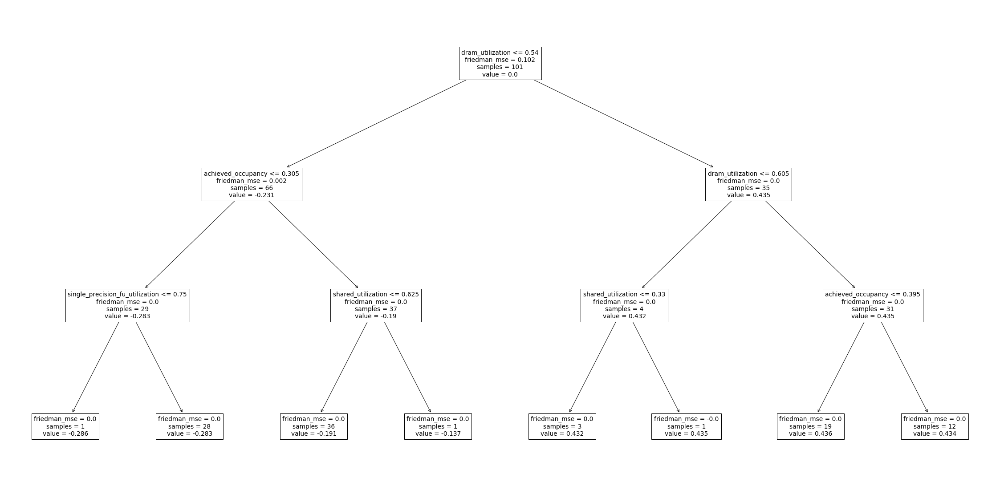

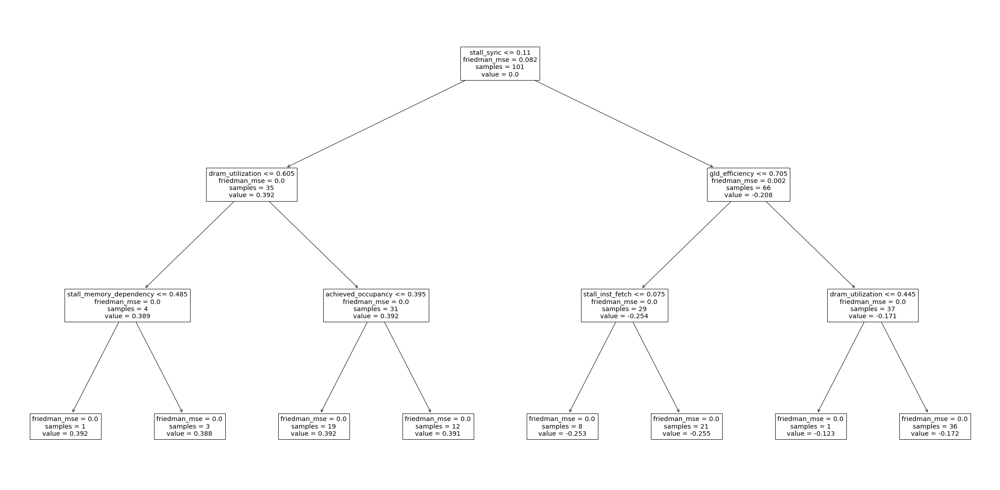

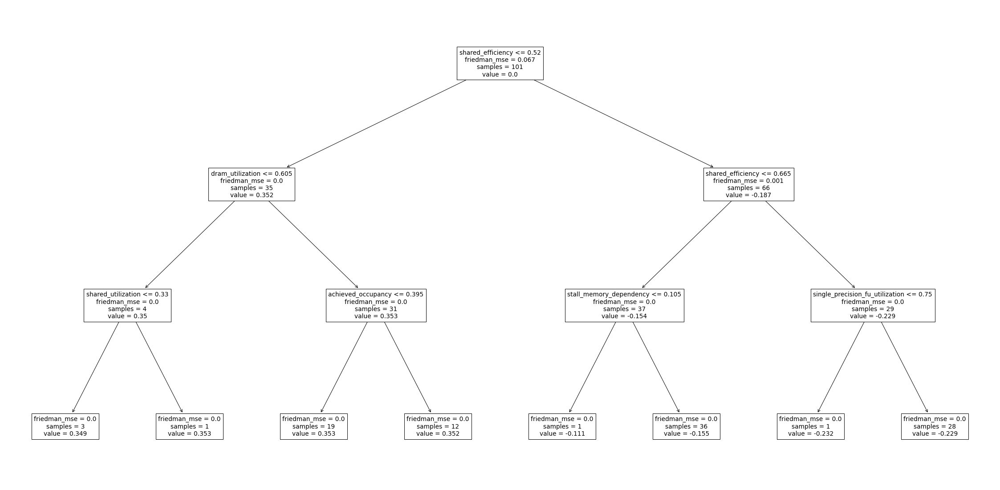

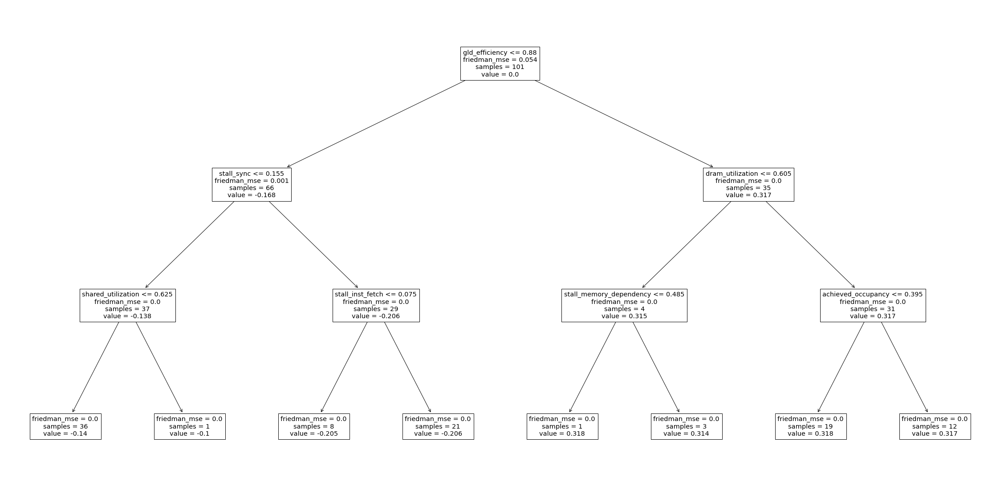

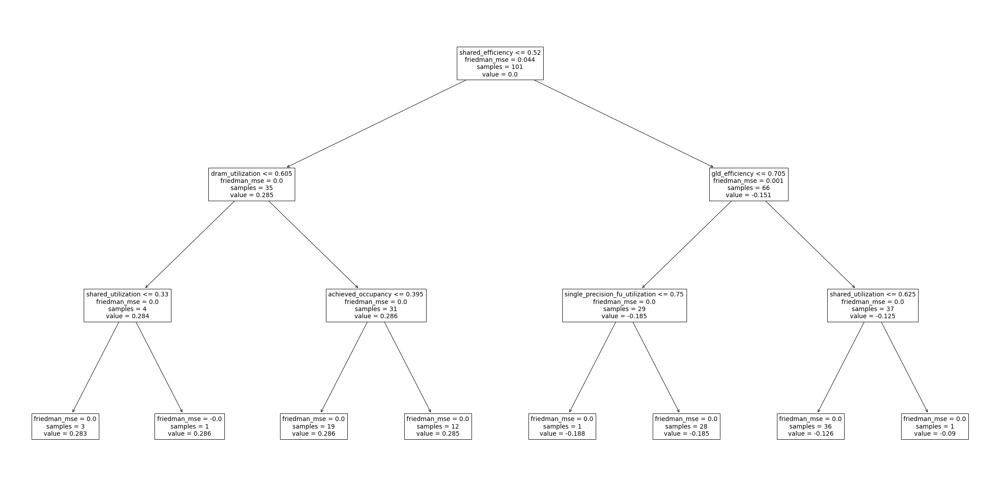

...

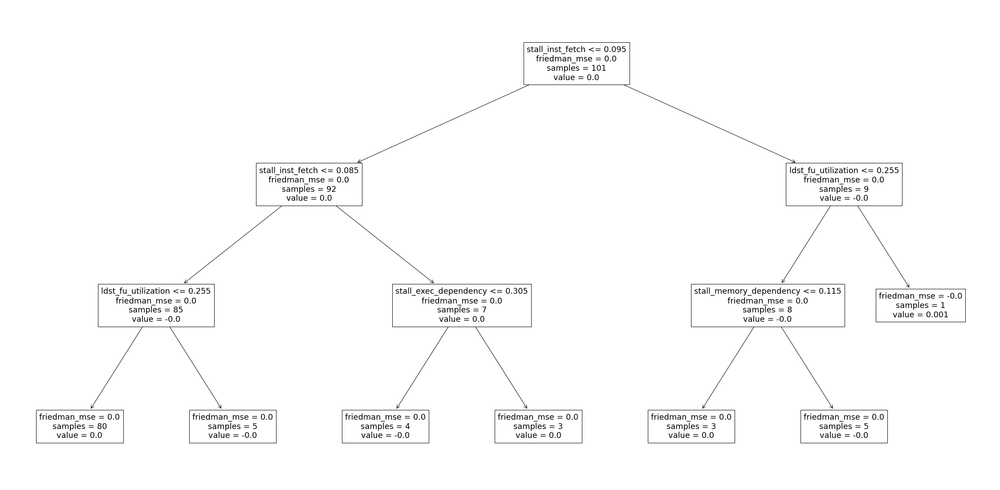

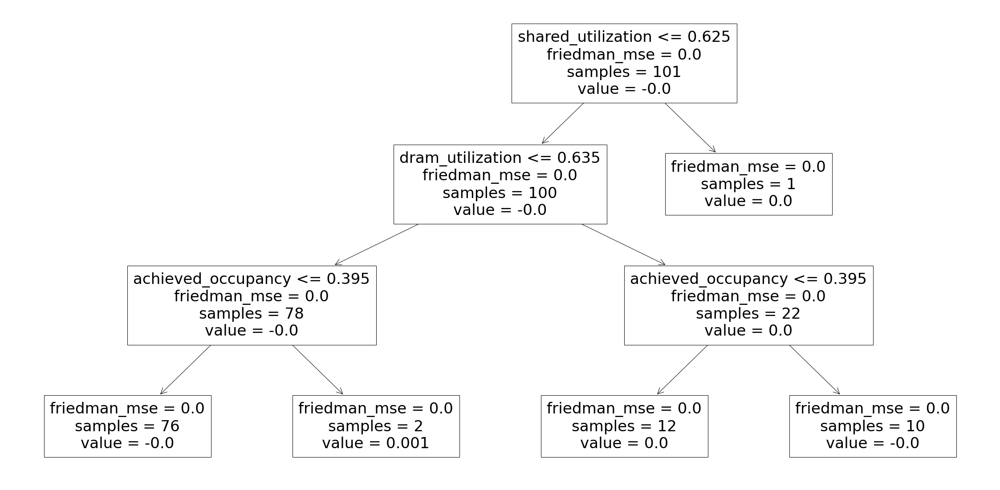

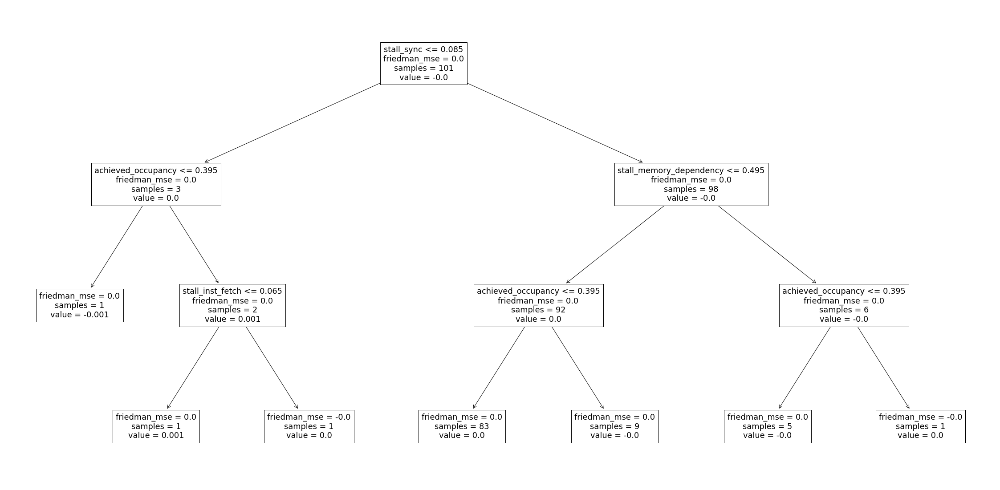

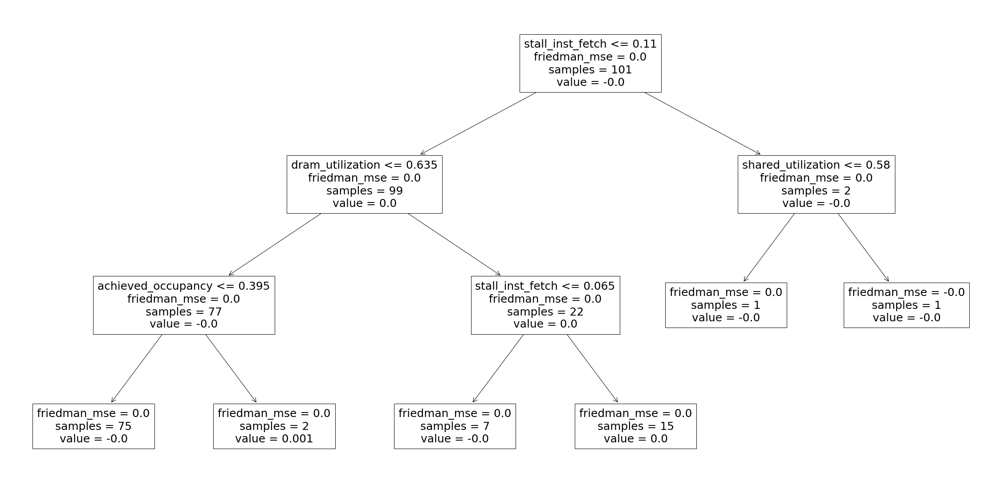

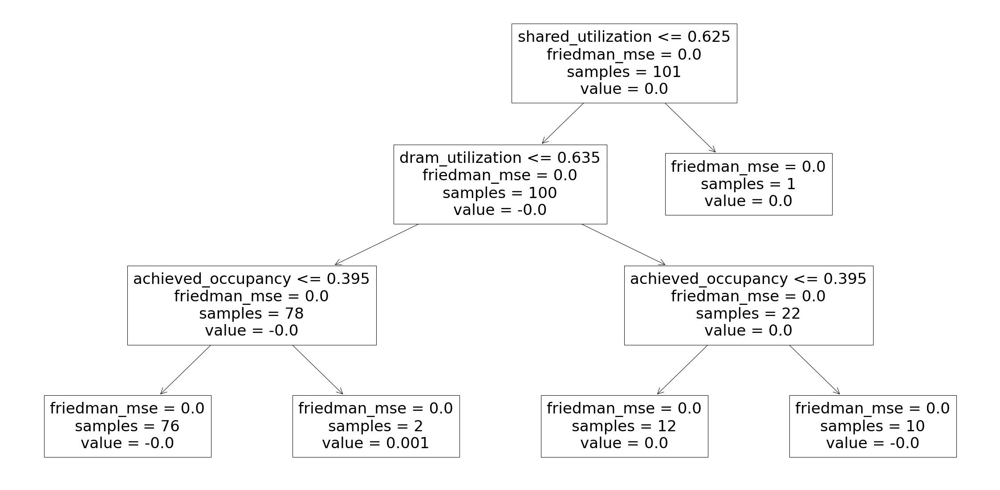

In [81]:
from sklearn.ensemble import GradientBoostingClassifier,GradientBoostingRegressor
from sklearn import tree
# model = GradientBoostingClassifier()
model = GradientBoostingRegressor()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
# print('Accuracy: ',accuracy_score(y_pred, y_test))
print('MAE: ',mean_absolute_error(y_pred, y_test))

for i in range(len(model.estimators_)):
    estimator = model.estimators_[i, 0]
    desc = tree.plot_tree(estimator, feature_names=columns)
    plt.show()

In [88]:
filter1=(X_train['stall_exec_dependency'] <= 0.3)
filter2=(X_train['single_precision_fu_utilization'] <= 0.7)
filter3=(X_train['gld_efficiency'] > 0.6)
# sum(filter1 & filter2)
y_train[filter1 & filter2 & filter3]

# y_train[X_train['gld_efficiency'] <= 0.6]

21     0.26984
60     0.26886
36     0.26294
39     0.26458
113    0.26201
66     0.26231
63     0.26709
33     0.26940
95     0.26579
98     0.26062
124    0.26475
18     0.26175
83     0.26205
72     0.26029
3      0.26075
104    0.26478
101    0.26424
57     0.26671
89     0.26576
107    0.26333
27     0.26232
127    0.26205
132    0.26367
12     0.26697
45     0.26445
48     0.26982
92     0.26844
24     0.26135
80     0.26295
Name: time, dtype: float64